# **Computer Vision Assignment-2**

In [3]:
# importing libraries
import cv2
import math
import numpy as np
import matplotlib.pyplot as plt

### **1) Image Mosaicing**

**1.1)** Use any feature detector and descriptor (e.g. SIFT) to find matches between two partially overlapping images. You can use inbuilt functions for this.

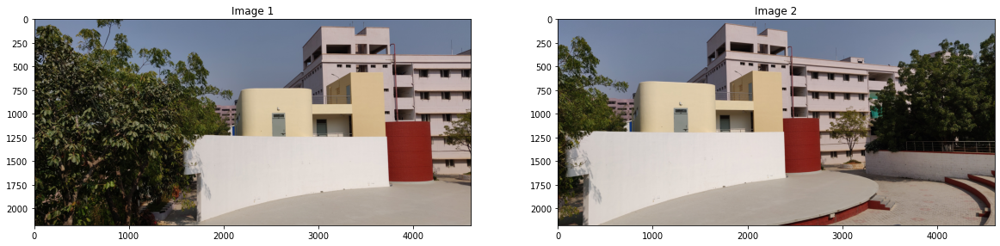

In [4]:
# Loading images
img1 = cv2.imread('../images/Image Mosaicing/1_1.jpg', cv2.IMREAD_COLOR)
img2 = cv2.imread('../images/Image Mosaicing/1_2.jpg', cv2.IMREAD_COLOR)
# Converting BGR to RGB
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

# Plotting
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 15))
ax[0].imshow(img1)
ax[0].title.set_text('Image 1')
ax[1].imshow(img2)
ax[1].title.set_text('Image 2')

In [5]:
def getMatches(img1, img2):
  # make sift object
  sift = cv2.ORB_create()

  # Find keypoints and descriptors
  keypoints_1, descriptors_1 = sift.detectAndCompute(img1,None)
  keypoints_2, descriptors_2 = sift.detectAndCompute(img2,None)

  # Feature matching using Brute Force Method (BFM)
  bf = cv2.BFMatcher()
  matches = bf.knnMatch(descriptors_1, descriptors_2, k=2)
  return keypoints_1, keypoints_2, matches

In [6]:
# Find only the best matches using ratio test
def filterPoints(matches, keypoints_1, keypoints_2, r=0.6):
  coords1, coords2 = [], []
  for i, j in matches:
    if i.distance < r * j.distance:
      coords1.append(keypoints_1[i.queryIdx].pt)
      coords2.append(keypoints_2[i.trainIdx].pt)
  return np.array(coords1), np.array(coords2)

In [7]:
# Function to return image of matches
def plotMatches(img1, img2, coords1, coords2, r=3):
  newImg = np.zeros((max(img1.shape[0], img2.shape[0]), img1.shape[1] + img2.shape[1], 3)).astype('uint8')
  newImg[0:img1.shape[0], 0:img1.shape[1]] = img1
  newImg[0:img2.shape[0], img1.shape[1]:img1.shape[1] + img2.shape[1]] = img2
  newc1 = np.rint(coords1).astype('int')
  newc2 = np.rint(coords2).astype('int')

  # Marking matches using lines and circles
  for i in range(newc1.shape[0]):
    colr = tuple(np.random.randint(0, 255, 3).tolist()) 
    cv2.circle(newImg, (newc1[i][0], newc1[i][1]), r+1, colr, 4)
    cv2.circle(newImg, (img1.shape[1] + newc2[i][0], newc2[i][1]), r+1, colr, 4)
    cv2.line(newImg, (newc1[i][0], newc1[i][1]), (newc2[i][0] + img1.shape[1], newc2[i][1]), colr, r)

  return newImg

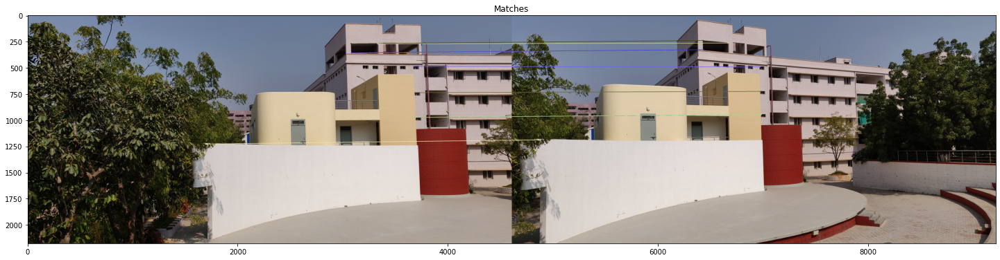

In [8]:
keypoints_1, keypoints_2, matches = getMatches(img1, img2)
coords1, coords2 = filterPoints(matches, keypoints_1, keypoints_2)

img = plotMatches(img1, img2, coords1, coords2)
# Plotting matches
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(25, 15))
ax.imshow(img)
ax.title.set_text('Matches')

**1.2)** Estimate the homography matrix between the two images robustly.

In [9]:
# Function to find homography matrix between 2 sets of points
def DLT(c1, c2):
  M = np.zeros((2 * len(c2), 9))
  # Buiding M matrix
  for i in range(len(c2)):
    M[2 * i][8] = c2[i][0]
    M[2 * i + 1][8] = c2[i][1]
    M[2 * i][2] = M[2 * i + 1][5] = -1
    for j in range(3):
      M[2 * i + 1][j] = M[2 * i][3 + j] = 0
    for j in range(2):
      M[2 * i][j] = -c1[i][j]
      M[2 * i + 1][3 + j] = -c1[i][j]
      M[2 * i][6 + j] = c2[i][0] * c1[i][j]
      M[2 * i + 1][6 + j] = c2[i][1] * c1[i][j]

  # SVD to find U, S, V matrices
  U, S, V = np.linalg.svd(M)
  # Finding projection matrix
  P = V[8].reshape((3, 3))
  return P / P[2, 2]

In [10]:
# Function to apply projection matrix and find MSE of prediction
def findError(P, C1, C2):
  # Convert points to homogenous coordinates
  C1Homogenous = np.hstack((C1, np.ones((C1.shape[0], 1)))).T

  # Apply projection matrix
  output = np.dot(P, C1Homogenous)

  # If point at infinity is present return infinity as error
  if 0 in output[2]:
    return math.inf

  # Converting to normal form
  output[:2] /= output[2]
  output = output[:2]

  # Finding error
  error = np.sum((output - C2.T) ** 2) / C2.shape[0]
  return np.sqrt(error)

In [11]:
# RANSAC Algorithm
def RANSAC(itr, C1, C2, points=6):
  # Best loss
  bestError = math.inf
  # best projection matrix
  bestProjectionMatrix = None

  # iterate itr times
  for _ in range(itr):
      # Getting random k distinct indices
      indices = np.array(range(len(C1)))
      np.random.shuffle(indices)
      indices = indices[:points]

      # Getting coords at those indices
      newWorld, newImage = [], []
      for i in indices:
          newImage.append(C2[i])
          newWorld.append(C1[i])
      newWorld, newImage = np.array(newWorld), np.array(newImage)
      
      # Applying DLT
      P = DLT(newWorld, newImage)

      # Finding error
      error = findError(P, newWorld, newImage)
      if error < bestError:
          bestError = error
          bestProjectionMatrix = P

  return bestError, bestProjectionMatrix

In [12]:
coords1, coords2 = filterPoints(matches, keypoints_1, keypoints_2)

In [13]:
error, P = RANSAC(1000, coords2, coords1)
print("Homography Matrix:\n")
print(P)
print('\nRMSE:', error)

Homography Matrix:

[[ 5.96068223e-01  3.15828179e-02  1.48675396e+03]
 [-1.08189132e-01  8.60505203e-01  2.16520526e+02]
 [-9.02325887e-05  8.12033212e-06  1.00000000e+00]]

RMSE: 0.18543469001664437


**1.3)** Transform one of the images to the other’s reference frame using the homography matrix.

In [14]:
# Function to crop out zeroes from borders of image
def crop(img):
  mask = img > 0
  return np.dstack([img[:, :, i][np.ix_(mask[:, :, i].any(1), mask[:, :, i].any(0))] for i in range(3)])

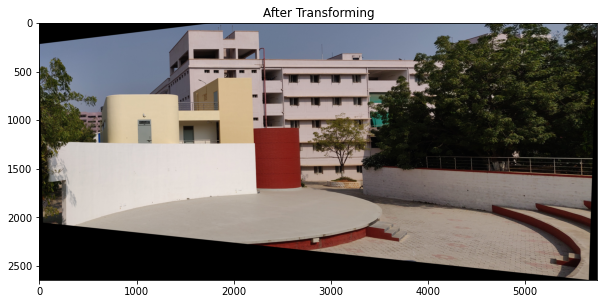

In [15]:
img = cv2.warpPerspective(img2, P, (img1.shape[1] + img2.shape[1], img1.shape[0] + img2.shape[0]))
img = crop(img)

# Plotting
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(10, 10))
ax.imshow(img)
ax.title.set_text('After Transforming')

**1.4)** Stitch the two images together.

In [16]:
def stitch(img1, img2, h):
  img = cv2.warpPerspective(img2, h, (img1.shape[1] + img2.shape[1], img1.shape[0] + img2.shape[0]))
  img[0:img1.shape[0], 0:img1.shape[1], :] = img1
  return crop(img)

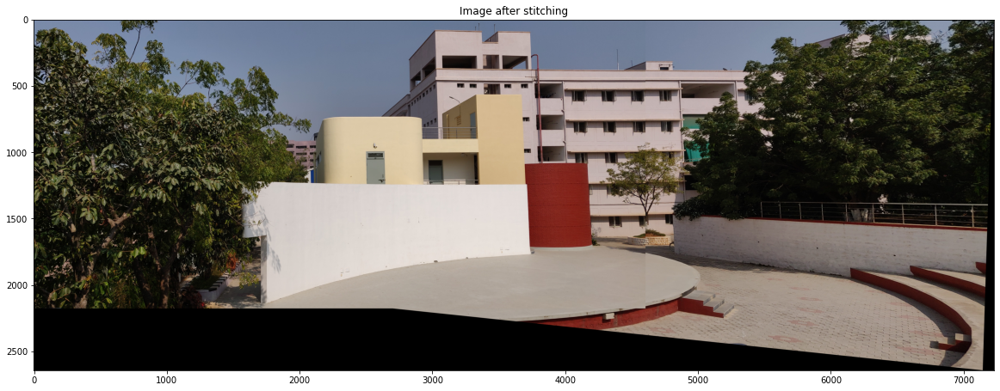

In [17]:
img = stitch(img1, img2, P)

# Plotting
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(20, 10))
ax.imshow(img)
ax.title.set_text('Image after stitching')

**1.5)** Repeat this for multiple images to produce a singly mosaic/panorama.

In [18]:
def makePanorama(images, r=0.6, points=6):
  currImg = images[0]
  for i in range(1, len(images)):
    keypoints_1, keypoints_2, matches = getMatches(images[i], currImg)
    coords1, coords2 = filterPoints(matches, keypoints_1, keypoints_2, r)
    error, P = RANSAC(1000, coords2, coords1, points)
    currImg = stitch(images[i], currImg, P)
  return currImg

In [19]:
# Load all images to make panorama with
images = []
for i in range(3, -1, -1):
  images.append(cv2.cvtColor(cv2.imread('../images/Image Mosaicing/1_' + str(i + 1) + '.jpg'), cv2.COLOR_BGR2RGB))

img = makePanorama(images)

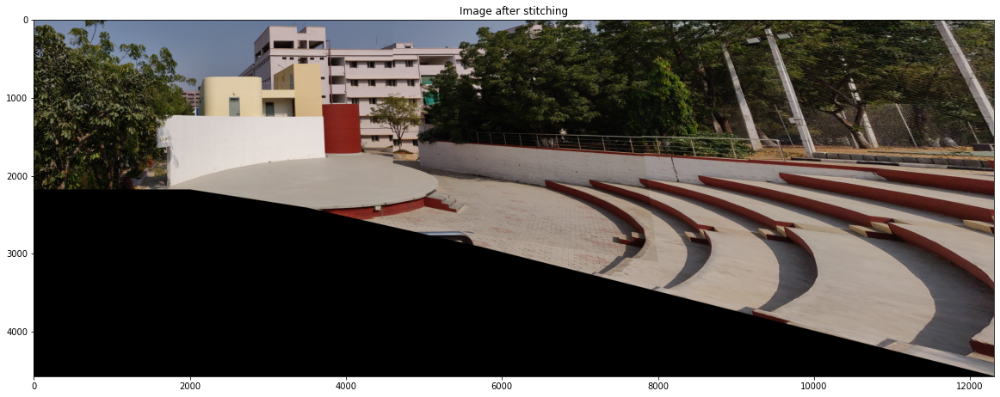

In [20]:
# Plotting
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(20, 10))
ax.imshow(img)
ax.title.set_text('Image after stitching')

**1.6)** Demonstrate the results on different scenes from the given data.

In [21]:
images = []
for i in range(2, -1, -1):
  images.append(cv2.cvtColor(cv2.imread('../images/Image Mosaicing/2_' + str(i + 1) + '.png'), cv2.COLOR_BGR2RGB))

img1 = makePanorama(images)

images = []
for i in range(2, -1, -1):
  images.append(cv2.cvtColor(cv2.imread('../images/Image Mosaicing/2_' + str(i + 4) + '.png'), cv2.COLOR_BGR2RGB))

img2 = makePanorama(images)
img = makePanorama([img2, img1])

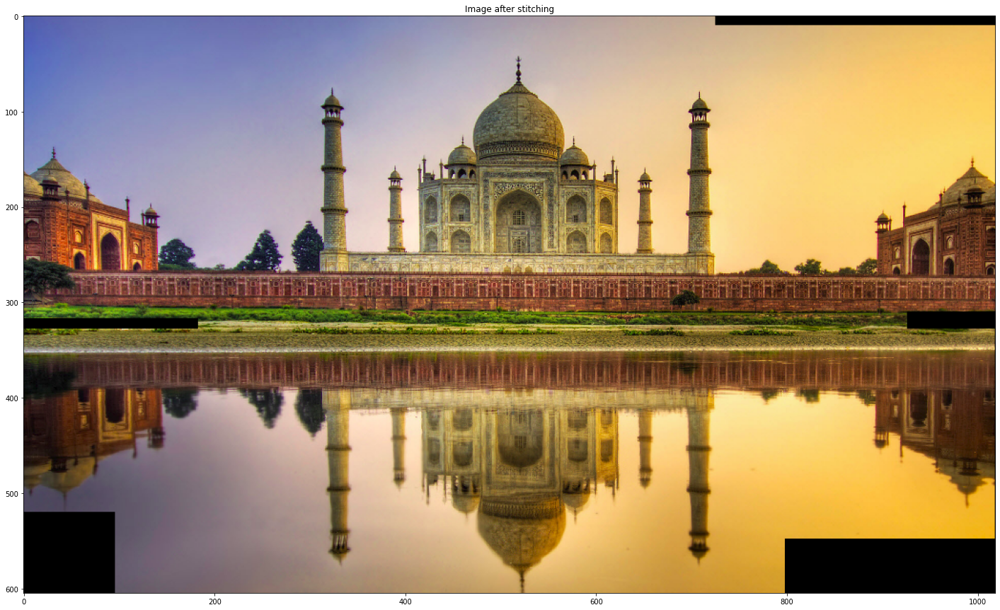

In [22]:
# Plotting
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(25, 15))
ax.imshow(img)
ax.title.set_text('Image after stitching')

In [23]:
images = []
for i in range(1, -1, -1):
  images.append(cv2.cvtColor(cv2.imread('../images/Image Mosaicing/3_' + str(i + 1) + '.png'), cv2.COLOR_BGR2RGB))

img = makePanorama(images, r=0.70, points=9)

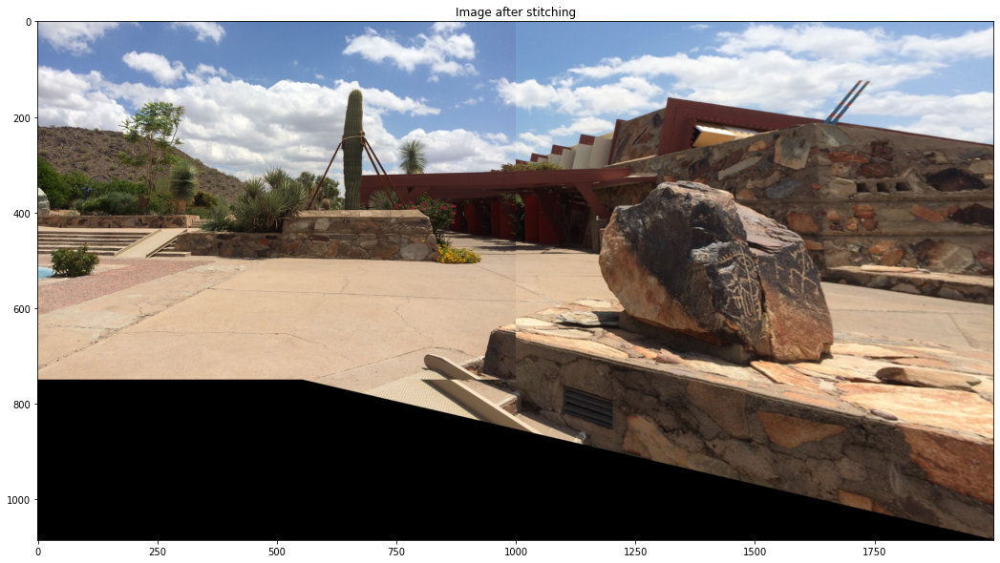

In [24]:
# Plotting
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(20, 10))
ax.imshow(img)
ax.title.set_text('Image after stitching')

In [25]:
images = []
for i in range(2):
  images.append(cv2.cvtColor(cv2.imread('../images/Image Mosaicing/5_' + str(i + 1) + '.jpg'), cv2.COLOR_BGR2RGB))

img1 = makePanorama(images)

images = []
for i in range(1, -1, -1):
  images.append(cv2.cvtColor(cv2.imread('../images/Image Mosaicing/5_' + str(i + 3) + '.jpg'), cv2.COLOR_BGR2RGB))

img2 = makePanorama(images)
img = makePanorama([img2, img1])

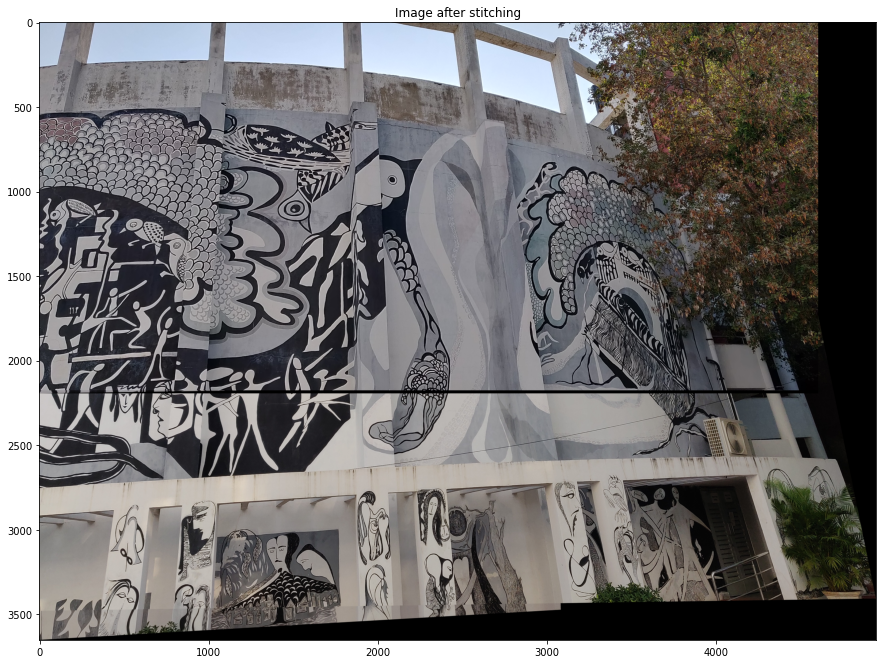

In [26]:
# Plotting
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15, 15))
ax.imshow(img)
ax.title.set_text('Image after stitching')

**1.7)** Additionally, capture a set of overlapping images of a scene with your camera and report the results on the same.

In [27]:
images = []
for i in range(2, -1, -1):
  images.append(cv2.cvtColor(cv2.imread('../images/own_' + str(i + 1) + '.jpg'), cv2.COLOR_BGR2RGB))

img = makePanorama(images, r=0.76)

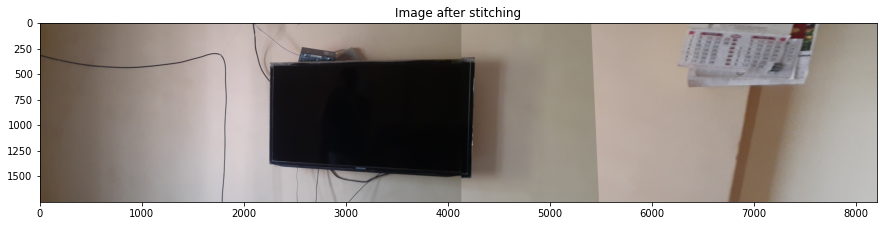

In [28]:
# Plotting
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15, 15))
ax.imshow(img[:1750, :8200])
ax.title.set_text('Image after stitching')

### **2) Stereo Correspondences**

**2.1)** You are given two images of the same scene, taken from different view points. Perform Intensity window-based correlation on the given pair of images.

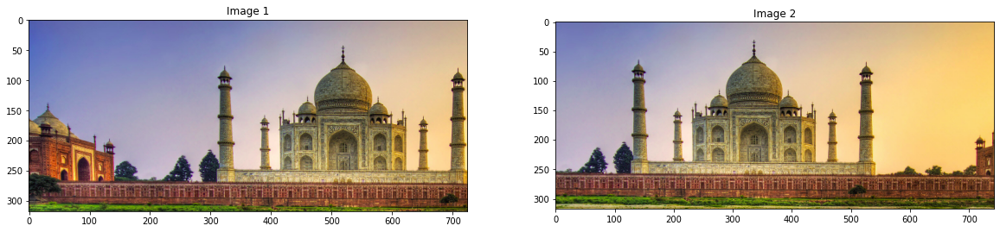

In [29]:
# Loading images
img1 = cv2.imread('../images/Stereo Correspondence/2_1.png', cv2.IMREAD_COLOR)
img2 = cv2.imread('../images/Stereo Correspondence/2_2.png', cv2.IMREAD_COLOR)
# Converting BGR to RGB
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

# Plotting
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 15))
ax[0].imshow(img1)
ax[0].title.set_text('Image 1')
ax[1].imshow(img2)
ax[1].title.set_text('Image 2')

In [33]:
def match(img1, img2, windowSize):
  _, _, _, maxLoc = cv2.minMaxLoc(cv2.matchTemplate(img1, img2, cv2.TM_CCORR_NORMED))
  return (maxLoc[0] + np.floor(windowSize / 2), maxLoc[1] + np.floor(windowSize / 2))

def windowMatching(img1, img2, windowSize=128):
  retImg = np.zeros((max(img1.shape[0], img2.shape[0]), img1.shape[1] + img2.shape[1], 3)).astype('uint8')
  retImg[0:img1.shape[0], 0:img1.shape[1]] = img1
  retImg[0:img2.shape[0], img1.shape[1]:img1.shape[1] + img2.shape[1]] = img2
  for i in range(0, img1.shape[0], windowSize):
    for j in range(0, img1.shape[1], windowSize):
      colr = tuple(np.random.randint(0, 255, 3).tolist()) 
      template = img1[i:i + windowSize, j:j + windowSize]
      p1 = (int(j + np.floor(windowSize / 2)), int(i + np.floor(windowSize / 2)))
      p2 = match(img2, template, windowSize)
      p2 = (int(p2[0] + img1.shape[1]), int(p2[1]))
      cv2.line(retImg, p1, p2, colr, 1)
      cv2.circle(retImg, p1, 4, colr, thickness=2)
      cv2.circle(retImg, p2, 4, colr, thickness=2)
  return retImg

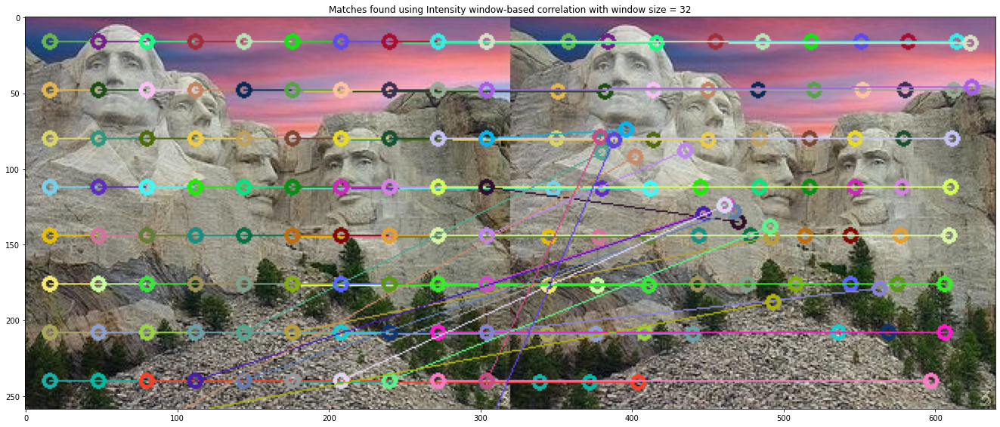

In [34]:
image_output = windowMatching(img1, img2, windowSize=32)
# Plotting
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(23, 15))
ax.imshow(image_output)
ax.title.set_text('Matches found using Intensity window-based correlation with window size = 32')

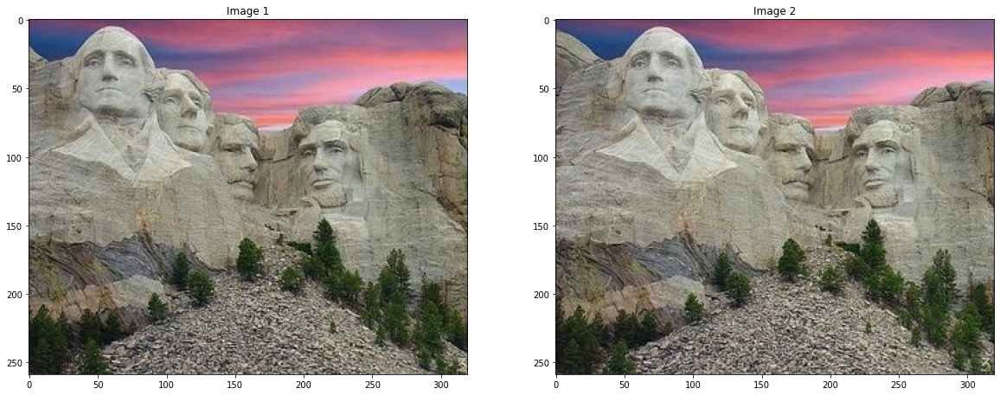

In [35]:
# Loading images
img1 = cv2.imread('../images/Stereo Correspondence/1_1.jpg', cv2.IMREAD_COLOR)
img2 = cv2.imread('../images/Stereo Correspondence/1_2.jpg', cv2.IMREAD_COLOR)
# Converting BGR to RGB
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

# Plotting
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20, 15))
ax[0].imshow(img1)
ax[0].title.set_text('Image 1')
ax[1].imshow(img2)
ax[1].title.set_text('Image 2')

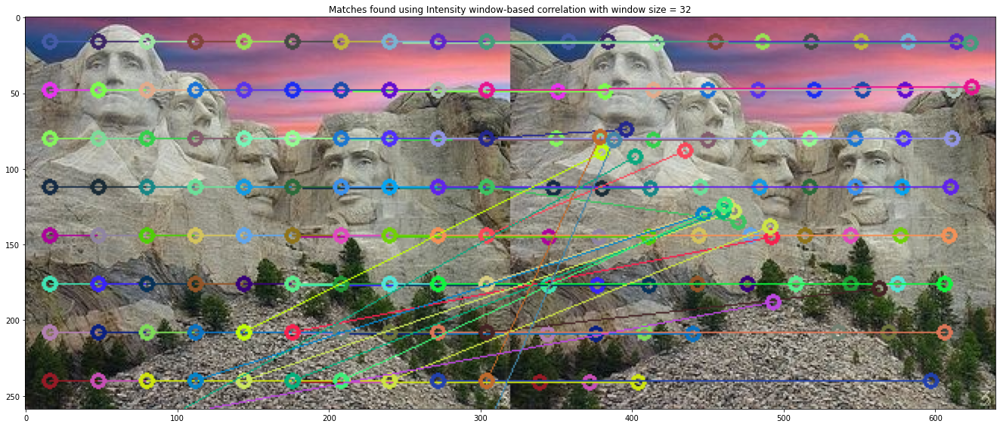

In [36]:
image_output = windowMatching(img1, img2, windowSize=32)
# Plotting
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(23, 15))
ax.imshow(image_output)
ax.title.set_text('Matches found using Intensity window-based correlation with window size = 32')

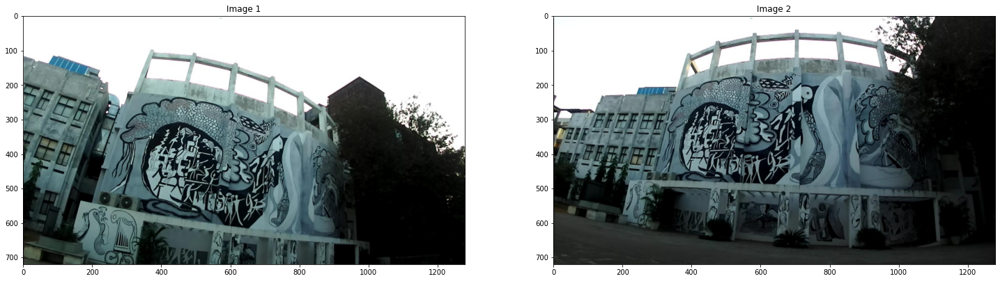

In [37]:
# Loading images
img1 = cv2.imread('../images/Stereo Correspondence/3_1.jpg', cv2.IMREAD_COLOR)
img2 = cv2.imread('../images/Stereo Correspondence/3_2.jpg', cv2.IMREAD_COLOR)
# Converting BGR to RGB
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

# Plotting
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(25, 15))
ax[0].imshow(img1)
ax[0].title.set_text('Image 1')
ax[1].imshow(img2)
ax[1].title.set_text('Image 2')

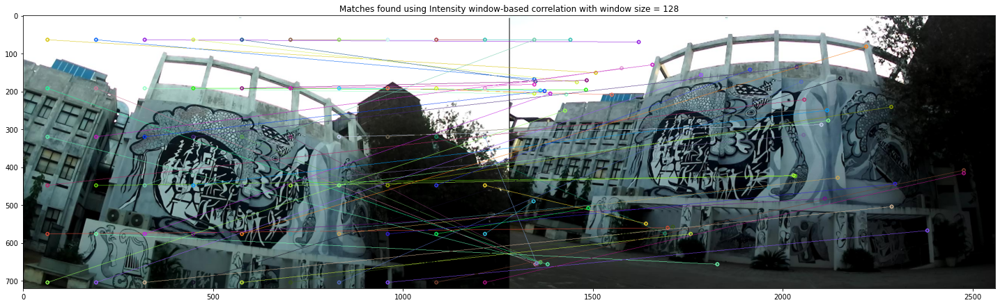

In [38]:
image_output = windowMatching(img1, img2, windowSize=128)
# Plotting
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(25, 15))
ax.imshow(image_output)
ax.title.set_text('Matches found using Intensity window-based correlation with window size = 128')

**2.2)** Recall that for a point in one image, its corresponding point in the other image is found along its epipolar line. Select few points in the first image and then plot their corresponding epipolar lines on the second. Repeat the same for the second image.

In [39]:
def plotLines(img1, img2, lines, coords1, coords2, r=1): 
	row, coll, ch = img1.shape 
	for row, pt1, pt2 in zip(lines, coords1, coords2): 
		colr = tuple(np.random.randint(0, 255, 3).tolist()) 
		a1, b1 = map(int, [0, -row[2] / row[1] ]) 
		a2, b2 = map(int, [coll, -(row[2] + row[0] * coll) / row[1] ]) 
		img1 = cv2.line(img1, (a1, b1), (a2, b2), colr, r) 
		img1 = cv2.circle(img1, tuple(pt1), 2, colr, -1) 
		img2 = cv2.circle(img2, tuple(pt2), 2, colr, -1) 
	return img1, img2 

In [40]:
# Loading images
img1 = cv2.imread('../images/Stereo Correspondence/1_1.jpg', cv2.IMREAD_COLOR)
img2 = cv2.imread('../images/Stereo Correspondence/1_2.jpg', cv2.IMREAD_COLOR)
# Converting BGR to RGB
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

keypoints_1, keypoints_2, matches = getMatches(img1, img2)
coords1, coords2 = filterPoints(matches, keypoints_1, keypoints_2)

leftPts = np.int32(coords1)
rightPts = np.int32(coords2) 
F, mask = cv2.findFundamentalMat(leftPts, rightPts, cv2.FM_LMEDS) 

# We select only inlier points 
leftPts = leftPts[mask.ravel() == 1] 
rightPts = rightPts[mask.ravel() == 1] 

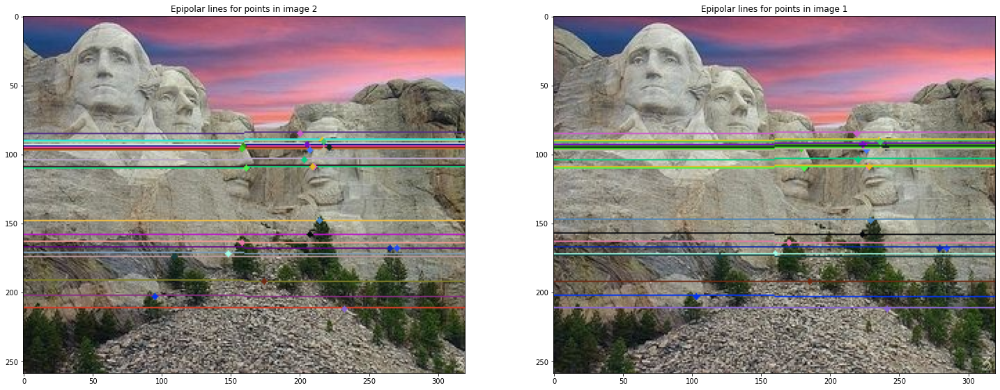

In [41]:
leftLines = np.hstack((rightPts, np.ones((len(rightPts), 1))))
leftLines = leftLines @ F
img3, _ = plotLines(img1, img2, 
					leftLines, leftPts, 
					rightPts) 

rightLines = np.hstack((leftPts, np.ones((len(leftPts), 1))))
rightLines = rightLines @ F

img4, _ = plotLines(img2, img1, 
					rightLines, rightPts, 
					leftPts) 

# Plotting
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(25, 15))
ax[0].imshow(img3)
ax[0].title.set_text('Epipolar lines for points in image 2')
ax[1].imshow(img4)
ax[1].title.set_text('Epipolar lines for points in image 1')

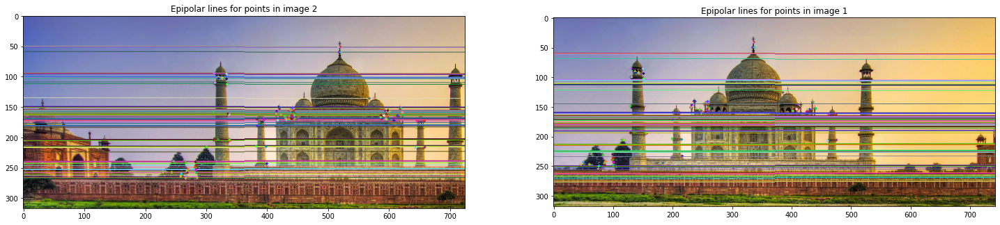

In [42]:
# Loading images
img1 = cv2.imread('../images/Stereo Correspondence/2_1.png', cv2.IMREAD_COLOR)
img2 = cv2.imread('../images/Stereo Correspondence/2_2.png', cv2.IMREAD_COLOR)
# Converting BGR to RGB
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

keypoints_1, keypoints_2, matches = getMatches(img1, img2)
coords1, coords2 = filterPoints(matches, keypoints_1, keypoints_2)

leftPts = np.int32(coords1)
rightPts = np.int32(coords2) 
F, mask = cv2.findFundamentalMat(leftPts, rightPts, cv2.FM_LMEDS) 

# We select only inlier points 
leftPts = leftPts[mask.ravel() == 1] 
rightPts = rightPts[mask.ravel() == 1] 

leftLines = np.hstack((rightPts, np.ones((len(rightPts), 1))))
leftLines = leftLines @ F
img3, _ = plotLines(img1, img2, 
					leftLines, leftPts, 
					rightPts) 

rightLines = np.hstack((leftPts, np.ones((len(leftPts), 1))))
rightLines = rightLines @ F

img4, _ = plotLines(img2, img1, 
					rightLines, rightPts, 
					leftPts) 

# Plotting
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(25, 15))
ax[0].imshow(img3)
ax[0].title.set_text('Epipolar lines for points in image 2')
ax[1].imshow(img4)
ax[1].title.set_text('Epipolar lines for points in image 1')

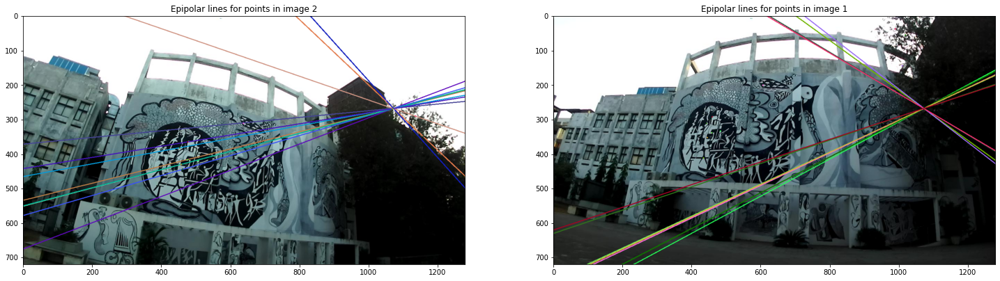

In [43]:
# Loading images
img1 = cv2.imread('../images/Stereo Correspondence/3_1.jpg', cv2.IMREAD_COLOR)
img2 = cv2.imread('../images/Stereo Correspondence/3_2.jpg', cv2.IMREAD_COLOR)
# Converting BGR to RGB
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

keypoints_1, keypoints_2, matches = getMatches(img1, img2)
coords1, coords2 = filterPoints(matches, keypoints_1, keypoints_2, r=0.8)

leftPts = np.int32(coords1)
rightPts = np.int32(coords2)
F, mask = cv2.findFundamentalMat(leftPts, rightPts, cv2.FM_LMEDS) 

# We select only inlier points 
leftPts = leftPts[mask.ravel() == 1] 
rightPts = rightPts[mask.ravel() == 1] 

leftLines = np.hstack((rightPts, np.ones((len(rightPts), 1))))
leftLines = leftLines @ F
img3, _ = plotLines(img1, img2, 
					leftLines, leftPts, 
					rightPts, r=2) 

rightLines = np.hstack((leftPts, np.ones((len(leftPts), 1))))
rightLines = rightLines @ F

img4, _ = plotLines(img2, img1, 
					rightLines, rightPts, 
					leftPts, r=2) 

# Plotting
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(25, 15))
ax[0].imshow(img3)
ax[0].title.set_text('Epipolar lines for points in image 2')
ax[1].imshow(img4)
ax[1].title.set_text('Epipolar lines for points in image 1')

**2.3)** Rectify the pair of images and on these new images, find the correspondences using greedy matching.

In [44]:
# function to rectify the two images
def rectify(img1, img2, r=0.5):
  keypoints_1, keypoints_2, matches = getMatches(img1, img2)
  coords1, coords2 = filterPoints(matches, keypoints_1, keypoints_2, r)
  coords1, coords2 = np.array(coords1, dtype='int32'), np.array(coords2, dtype='int32')
  F, mask = cv2.findFundamentalMat(coords1, coords2, cv2.FM_LMEDS)
  coords1, coords2 = coords1[mask.ravel() == 1], coords2[mask.ravel() == 1]
  _, M1, M2 = cv2.stereoRectifyUncalibrated(coords1, coords2, F, img1.shape[:2])
  return cv2.warpPerspective(img1, M1, img1.shape[:2][::-1]), \
         cv2.warpPerspective(img2, M2, img2.shape[:2][::-1])

In [47]:
# Find correlation b/w two templates
def correlationBwTemplate(x, y):
  x = x - (np.sum(x) / np.size(x))
  y = y - (np.sum(y) / np.size(y))
  return (x * y).sum() / np.sqrt((x * x).sum() * (y * y).sum())

# Apply greey method
def applyGreedy(template1, img, row, windowSize):
  maxi = -math.inf
  columnBest = 0

  for i in range(0, img.shape[1], windowSize):
    template2 = img[row:row + windowSize, i:i + windowSize]
    if (template1.shape[1] > template2.shape[1]):
      template1 = template1[:, :template2.shape[1]]
    else:
      template2 = template2[:, :template1.shape[1]]
    c = correlationBwTemplate(template1, template2)
    if (c > maxi):
      maxi = c
      columnBest = i

  return (columnBest + np.floor(windowSize / 2), row + np.floor(windowSize / 2))

def greedyMatch(img1, img2, windowSize):
  retImg = np.zeros((max(img1.shape[0], img2.shape[0]), img1.shape[1] + img2.shape[1], 3)).astype('uint8')
  retImg[0:img1.shape[0], 0:img1.shape[1]] = img1
  retImg[0:img2.shape[0], img1.shape[1]:img1.shape[1] + img2.shape[1]] = img2
  for i in range(0, img1.shape[0], windowSize):
    for j in range(0, img1.shape[1], windowSize):
      template = img1[i:i + windowSize, j:j + windowSize]
      colr = tuple(np.random.randint(0, 255, 3).tolist()) 
      p1 = (int(j + np.floor(windowSize / 2)), int(i + np.floor(windowSize / 2)))
      p2 = applyGreedy(template, img2, i, windowSize)
      p2 = (int(p2[0] + img1.shape[1]), int(p2[1]))
      cv2.line(retImg, p1, p2, colr, 1)
      cv2.circle(retImg, p1, 4, colr, thickness=2)
      cv2.circle(retImg, p2, 4, colr, thickness=2)
  return retImg

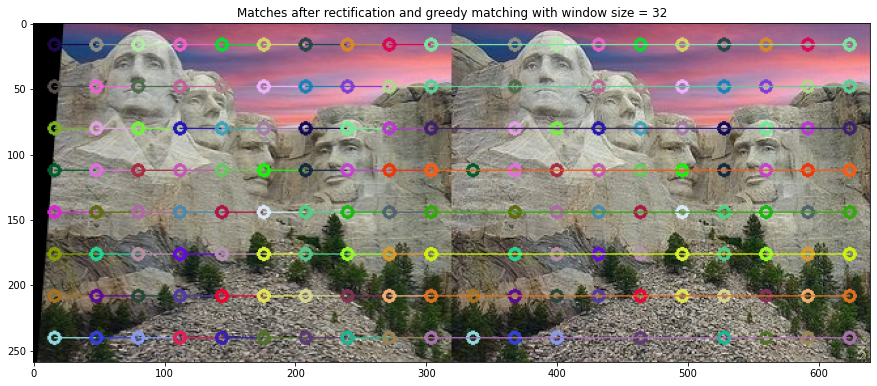

In [48]:
# Loading images
img1 = cv2.imread('../images/Stereo Correspondence/1_1.jpg', cv2.IMREAD_COLOR)
img2 = cv2.imread('../images/Stereo Correspondence/1_2.jpg', cv2.IMREAD_COLOR)
# Converting BGR to RGB
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

img1, img2 = rectify(img1, img2, 0.5)
img_1, img_2 = np.zeros((max(img1.shape[0], img2.shape[0]), max(img1.shape[1], img2.shape[1]), 3)).astype('uint8'), \
                np.zeros((max(img1.shape[0], img2.shape[0]), max(img1.shape[1], img2.shape[1]), 3)).astype('uint8')
img_1[0:img1.shape[0], 0:img1.shape[1]] = img1
img_2[0:img2.shape[0], 0:img2.shape[1]] = img2
greedyImg = greedyMatch(img_1, img_2, 32)

# Plotting
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15, 15))
ax.imshow(greedyImg)
ax.title.set_text('Matches after rectification and greedy matching with window size = 32')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in double_scalars
  """


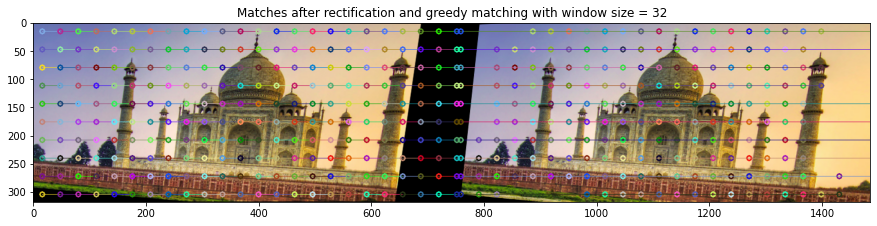

In [49]:
# Loading images
img1 = cv2.imread('../images/Stereo Correspondence/2_1.png', cv2.IMREAD_COLOR)
img2 = cv2.imread('../images/Stereo Correspondence/2_2.png', cv2.IMREAD_COLOR)
# Converting BGR to RGB
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

img1, img2 = rectify(img1, img2, 0.5)
img_1, img_2 = np.zeros((max(img1.shape[0], img2.shape[0]), max(img1.shape[1], img2.shape[1]), 3)).astype('uint8'), \
                np.zeros((max(img1.shape[0], img2.shape[0]), max(img1.shape[1], img2.shape[1]), 3)).astype('uint8')
img_1[0:img1.shape[0], 0:img1.shape[1]] = img1
img_2[0:img2.shape[0], 0:img2.shape[1]] = img2
greedyImg = greedyMatch(img_1, img_2, 32)

# Plotting
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15, 15))
ax.imshow(greedyImg)
ax.title.set_text('Matches after rectification and greedy matching with window size = 32')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: invalid value encountered in double_scalars
  """


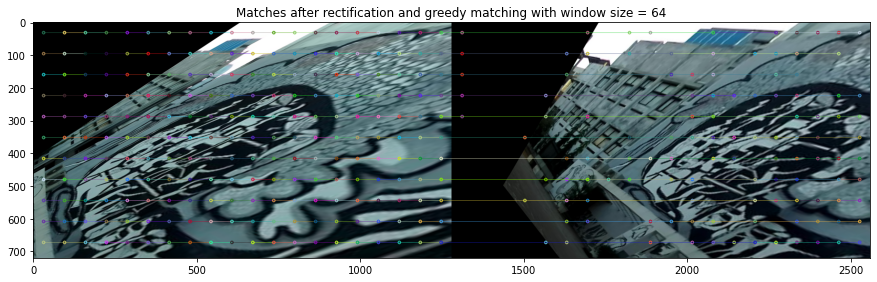

In [51]:
# Loading images
img1 = cv2.imread('../images/Stereo Correspondence/3_1.jpg', cv2.IMREAD_COLOR)
img2 = cv2.imread('../images/Stereo Correspondence/3_2.jpg', cv2.IMREAD_COLOR)
# Converting BGR to RGB
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

img1, img2 = rectify(img1, img2, 0.94)
img_1, img_2 = np.zeros((max(img1.shape[0], img2.shape[0]), max(img1.shape[1], img2.shape[1]), 3)).astype('uint8'), \
                np.zeros((max(img1.shape[0], img2.shape[0]), max(img1.shape[1], img2.shape[1]), 3)).astype('uint8')
img_1[0:img1.shape[0], 0:img1.shape[1]] = img1
img_2[0:img2.shape[0], 0:img2.shape[1]] = img2
greedyImg = greedyMatch(img_1, img_2, 64)

# Plotting
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(15, 15))
ax.imshow(greedyImg)
ax.title.set_text('Matches after rectification and greedy matching with window size = 64')

**2.4)** Compare the Brute force and Greedy based solution for the stereo correspondence problem.

1) When we get the rectified images, we try to map the points from one to another.

2) Incase of the greedy method the time complexity is less because we match templates only along the epipolar lines instead of matching with all the templates.

**2.5)** **BONUS:** Perform dense SIFT-based matching on the given pair of Images and
give the comparison with that of Intensity window-based correlation.

**NOTE:** SIFT was causing my laptop to crash so I have used ORB method. The idea still remains the same.

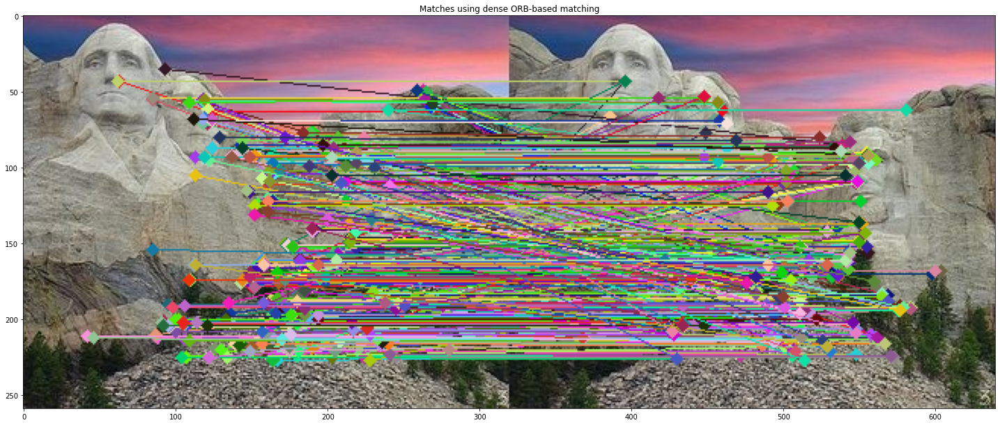

In [52]:
# Loading images
img1 = cv2.imread('../images/Stereo Correspondence/1_1.jpg', cv2.IMREAD_COLOR)
img2 = cv2.imread('../images/Stereo Correspondence/1_2.jpg', cv2.IMREAD_COLOR)
# Converting BGR to RGB
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

keypoints_1, keypoints_2, matches = getMatches(img1, img2)
coords1, coords2 = filterPoints(matches, keypoints_1, keypoints_2, r=1)

img = plotMatches(img1, img2, coords1, coords2, r=1)
# Plotting matches
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(25, 15))
ax.imshow(img)
ax.title.set_text('Matches using dense ORB-based matching')

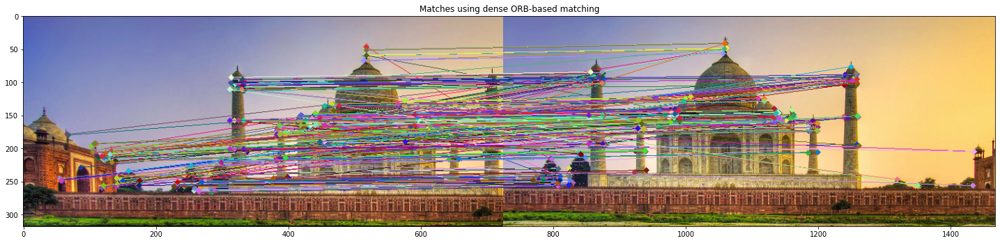

In [53]:
# Loading images
img1 = cv2.imread('../images/Stereo Correspondence/2_1.png', cv2.IMREAD_COLOR)
img2 = cv2.imread('../images/Stereo Correspondence/2_2.png', cv2.IMREAD_COLOR)
# Converting BGR to RGB
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

keypoints_1, keypoints_2, matches = getMatches(img1, img2)
coords1, coords2 = filterPoints(matches, keypoints_1, keypoints_2, r=1)

img = plotMatches(img1, img2, coords1, coords2, r=1)
# Plotting matches
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(25, 15))
ax.imshow(img)
ax.title.set_text('Matches using dense ORB-based matching')

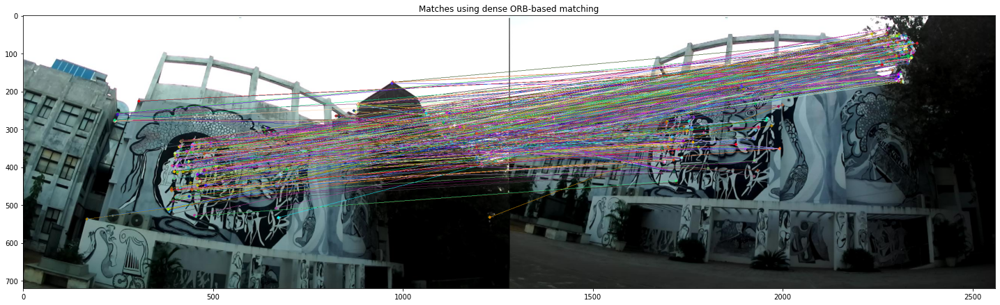

In [54]:
# Loading images
img1 = cv2.imread('../images/Stereo Correspondence/3_1.jpg', cv2.IMREAD_COLOR)
img2 = cv2.imread('../images/Stereo Correspondence/3_2.jpg', cv2.IMREAD_COLOR)
# Converting BGR to RGB
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

keypoints_1, keypoints_2, matches = getMatches(img1, img2)
coords1, coords2 = filterPoints(matches, keypoints_1, keypoints_2, r=1)

img = plotMatches(img1, img2, coords1, coords2, r=1)
# Plotting matches
fig, ax = plt.subplots(nrows=1, ncols=1, figsize=(25, 15))
ax.imshow(img)
ax.title.set_text('Matches using dense ORB-based matching')

We can see that the matching is much better which would help in better rectification as compared to intensity matching.